## Image Processing

- Goals
 - Learn various image processing operations
 - Perform image operations such as Smoothing, Blurring, Morphological Operations
 - Grab properties such as color spaces and histograms

#### Class 1 - Color Mappngs

- So far we worked with RGB color spaces
- There are some other models like HSL (Hue, Saturation, Lightness) and
HSV(Hue, Saturation and Value)
- HSL and HSV are more aligned with human vision actually perceives
- While in this course we deal with RGB images, its a good idea to understand about HSV and HSL colorspaces

In [1]:
import cv2
import matplotlib.pyplot as plt

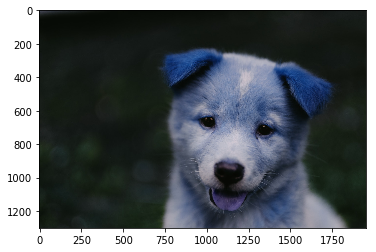

In [2]:
img = cv2.imread('../Data/00-puppy.jpg')
plt.imshow(img) # BGR cahannel

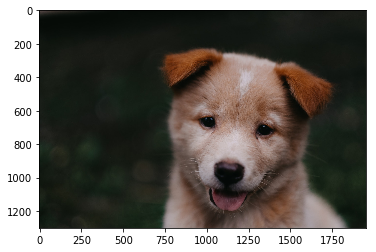

In [3]:
# converting to RGB
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))

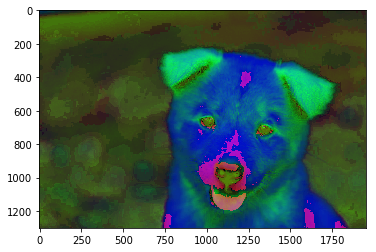

In [5]:
# converting to HSV
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2HSV))

#### Class 2 - Blending and Pasting Images

Blend images   
Formula:  
new_pixel = alpha x pixel_1(1st image) + beta x pixel_2(2nd image) + gamma

In [7]:
img1 = cv2.cvtColor(cv2.imread('../Data/dog_backpack.png'),
                    cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread('../Data/watermark_no_copy.png'),
                    cv2.COLOR_BGR2RGB)

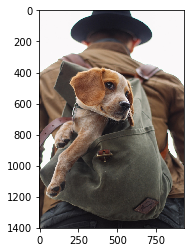

In [8]:
plt.imshow(img1)

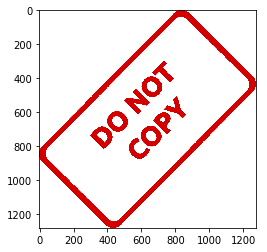

In [9]:
plt.imshow(img2)

In [10]:
print('img1 shape: ',img1.shape)
print('img2 shape: ',img2.shape)

img1 shape:  (1401, 934, 3)
img2 shape:  (1280, 1277, 3)


In [11]:
# blending images of same size

In [12]:
#resize to equal sizes
img1 = cv2.resize(img1,(1200,1200))
img2 = cv2.resize(img2,(1200,1200))

In [13]:
print('img1 shape: ',img1.shape)
print('img2 shape: ',img2.shape)

img1 shape:  (1200, 1200, 3)
img2 shape:  (1200, 1200, 3)


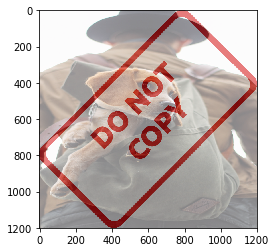

In [14]:
blended = cv2.addWeighted(src1 = img1,alpha = 0.5,
                         src2 = img2,beta = 0.5,gamma = 0)
plt.imshow(blended)

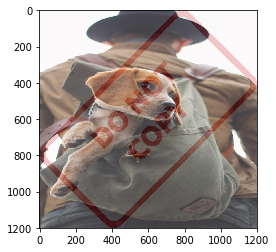

In [15]:
blended = cv2.addWeighted(src1 = img1,alpha = 0.8,
                         src2 = img2,beta = 0.2,gamma = 0)
plt.imshow(blended)

In [18]:
#Overlay small image on top of larger image
#numpy reassignment

In [19]:
img1 = cv2.cvtColor(cv2.imread('../Data/dog_backpack.png'),
                    cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread('../Data/watermark_no_copy.png'),
                    cv2.COLOR_BGR2RGB)

In [20]:
img2 = cv2.resize(img2,(600,600)) #img2 is smaller than img1

In [26]:
large_img = img1
small_img = img2

In [22]:
x_offset = 0
y_offset = 0

In [23]:
## in numpy x axis is vertical and y axis is horizontal

In [24]:
x_end = x_offset + small_img.shape[1]
y_end = y_offset + small_img.shape[0]

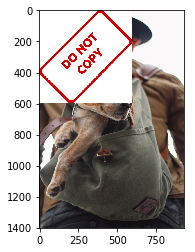

In [27]:
large_img[y_offset:y_end,x_offset:x_end] = small_img
plt.imshow(large_img)

In [17]:
# Blend images of different sizes

In [28]:
img1 = cv2.cvtColor(cv2.imread('../Data/dog_backpack.png'),
                    cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread('../Data/watermark_no_copy.png'),
                    cv2.COLOR_BGR2RGB)

In [29]:
img2 = cv2.resize(img2,(600,600)) #img2 is smaller than img1

In [30]:
img1.shape

(1401, 934, 3)

In [31]:
x_offset = 934 - 600
y_offset = 1401 - 600

In [32]:
img2.shape

(600, 600, 3)

In [33]:
rows,cols,channels = img2.shape

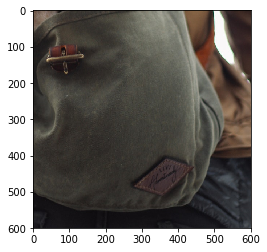

In [34]:
#region of interest
roi = img1[y_offset:1401,x_offset:934]
plt.imshow(roi)

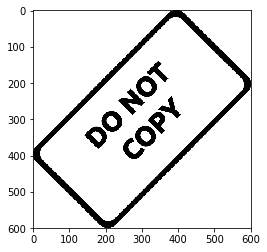

In [35]:
img2gray = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)
plt.imshow(img2gray,cmap = 'gray')

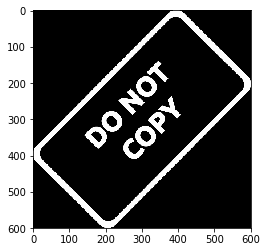

In [36]:
mask_inv = cv2.bitwise_not(img2gray)
plt.imshow(mask_inv,cmap='gray')

In [37]:
mask_inv.shape

(600, 600)

In [38]:
#you can see the image is 2D now

In [39]:
import numpy as np

In [43]:
white_bgd = np.full(img2.shape,255,dtype=np.uint8)
white_bgd.shape

(600, 600, 3)

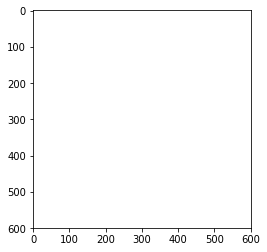

In [44]:
plt.imshow(white_bgd)

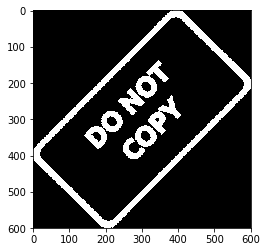

In [45]:
bk = cv2.bitwise_or(white_bgd,white_bgd,mask=mask_inv)
plt.imshow(bk)

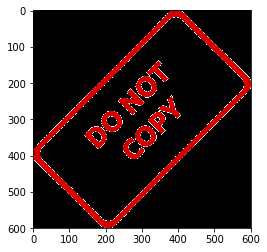

In [46]:
fg = cv2.bitwise_or(img2,img2,mask = mask_inv)
plt.imshow(fg)

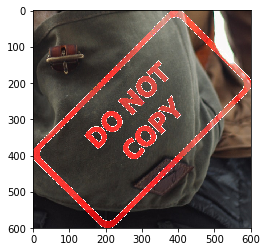

In [47]:
final_roi = cv2.bitwise_or(roi,fg)
plt.imshow(final_roi)

In [48]:
large_img = img1
small_img = final_roi

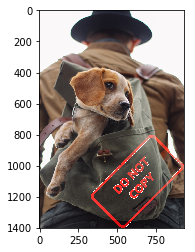

In [49]:
large_img[y_offset:y_offset+small_img.shape[0],
         x_offset:x_offset+small_img.shape[1]] = small_img
plt.imshow(large_img)

#### Class 3 Image Threshodling

- Thresholding is fundamentally a very simple method of segmenting an image into different parts
- Threshodling will convert an image to white or black

In [1]:
import cv2
import matplotlib.pyplot as plt

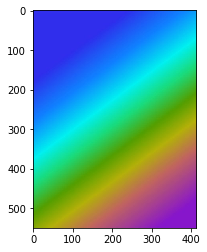

In [2]:
img = cv2.imread('../Data/rainbow.jpg')
plt.imshow(img)

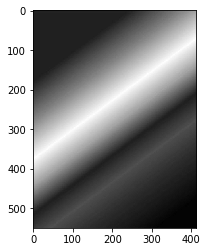

In [4]:
#read as grayscale
img_gray = cv2.imread('../Data/rainbow.jpg',0)
plt.imshow(img_gray,cmap='gray')

###### Threshold types

In [12]:
ret,thresh1 = cv2.threshold(img_gray,thresh=img.max()/2,maxval = 255,
             type = cv2.THRESH_BINARY)

In [13]:
ret

127.0

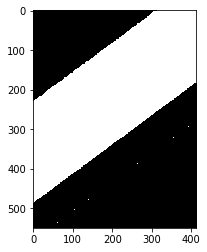

In [14]:
plt.imshow(thresh1,cmap = 'gray')

127.0


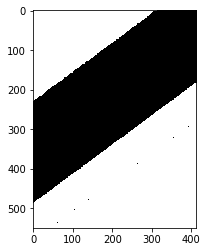

In [16]:
ret,thresh1 = cv2.threshold(img_gray,thresh=img.max()/2,maxval = 255,
             type = cv2.THRESH_BINARY_INV)
print(ret)
plt.imshow(thresh1,cmap='gray')

127.0


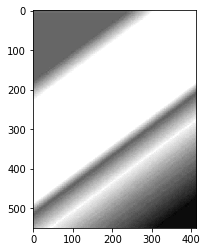

In [17]:
ret,thresh1 = cv2.threshold(img_gray,thresh=img.max()/2,maxval = 255,
             type = cv2.THRESH_TRUNC)
print(ret)
plt.imshow(thresh1,cmap='gray')

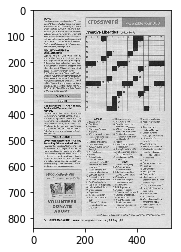

In [18]:
img = cv2.imread('../Data/crossword.jpg',0)
plt.imshow(img,cmap='gray')

In [21]:
def show_img(img):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap = 'gray')

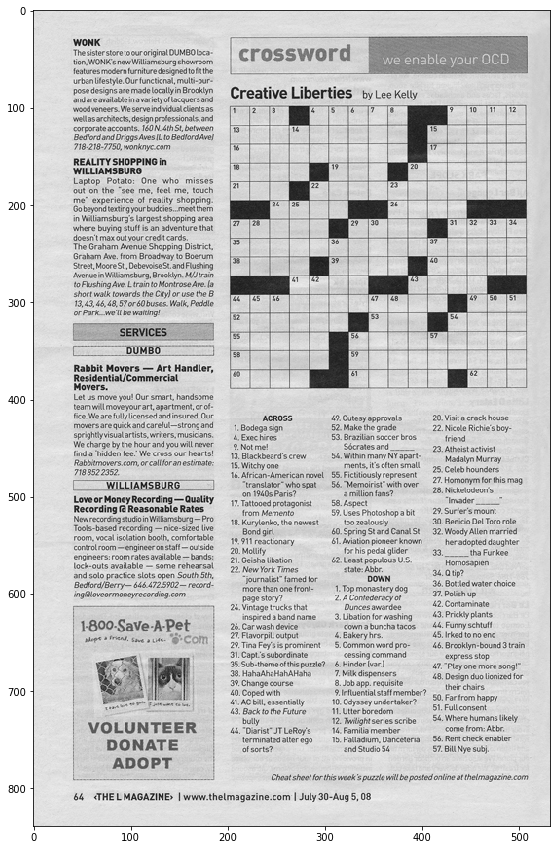

In [22]:
show_img(img)

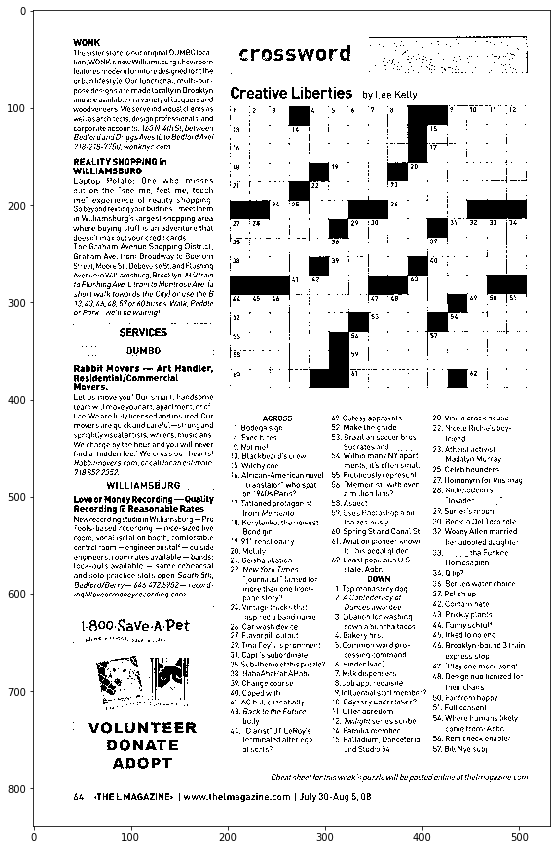

In [24]:
ret,thr1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY)
show_img(thr1)

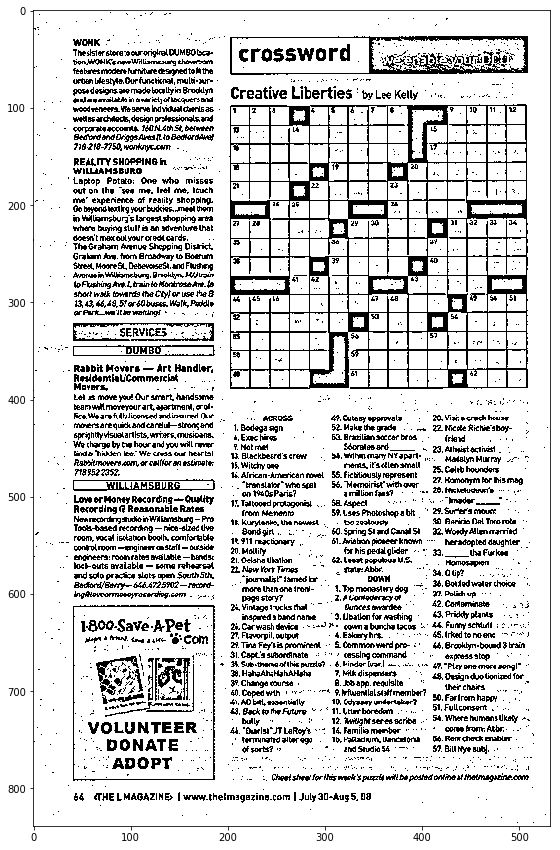

In [26]:
thr2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,
                            cv2.THRESH_BINARY,11,9)
show_img(thr2)

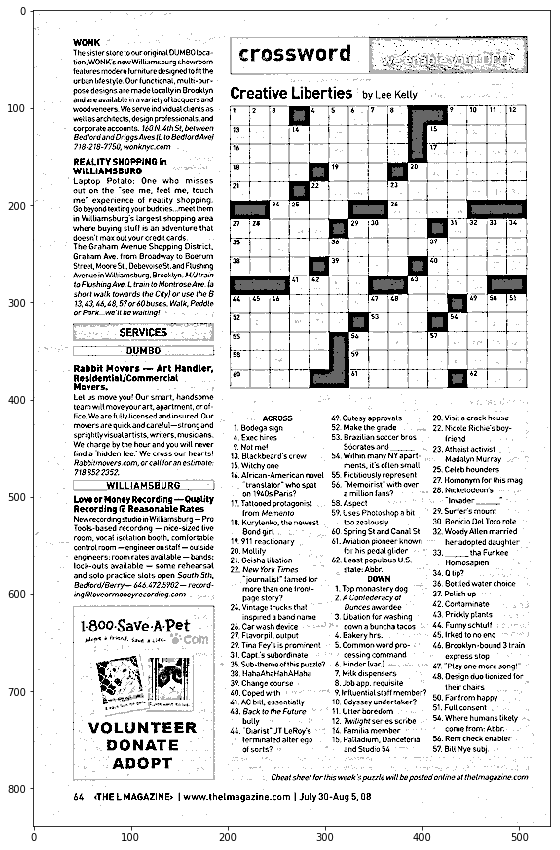

In [27]:
blended = cv2.addWeighted(thr1,0.7,thr2,0.4,0)
show_img(blended)

#### Class 4 Blurring and Smoothing

- Blurring/Smoothing is combined with edge detection
- Edge detection algorithms detect too many edges when shown a high resolution image without any blurring

- Methods
 - Gamma Correction:
   - can be applied to an image to make it appear brighter or darker depending on the Gamma value chosen
 - Kernel Based Filters
   - can be applied over an image to produce a variet of effects
  

In [28]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

In [29]:
def load_img():
    img = cv2.imread('../Data/bricks.jpg').astype(np.float32) / 255
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    return img

In [32]:
def show_img(img):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap = 'gray')

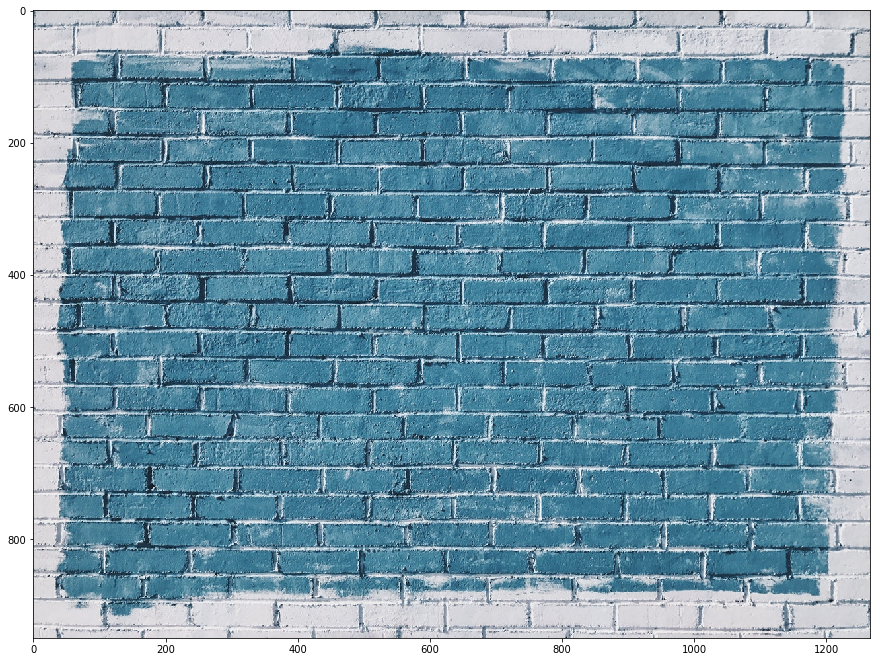

In [33]:
i = load_img()
show_img(i)

In [34]:
gamma = 1/4

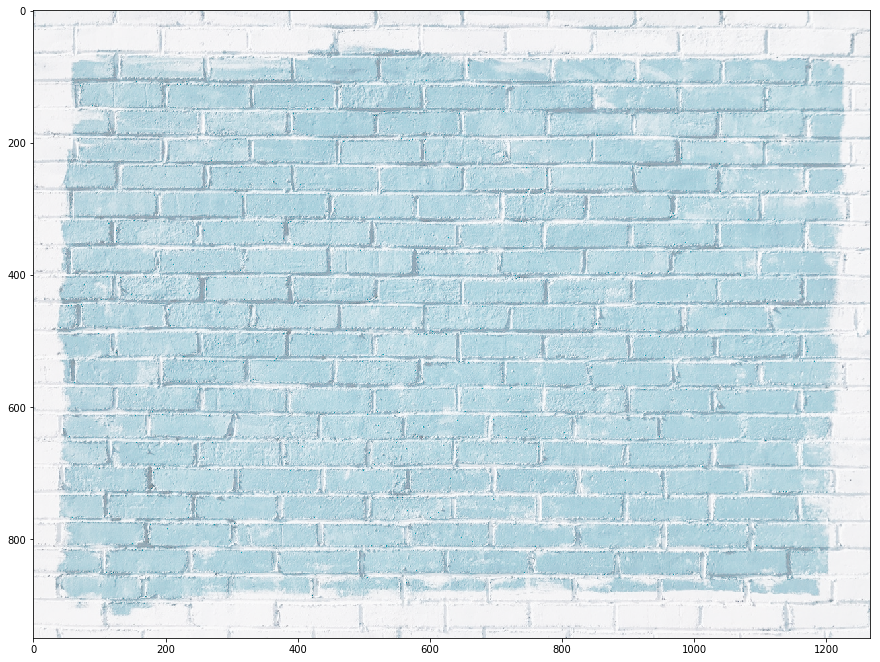

In [35]:
result = np.power(i,gamma)
show_img(result)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


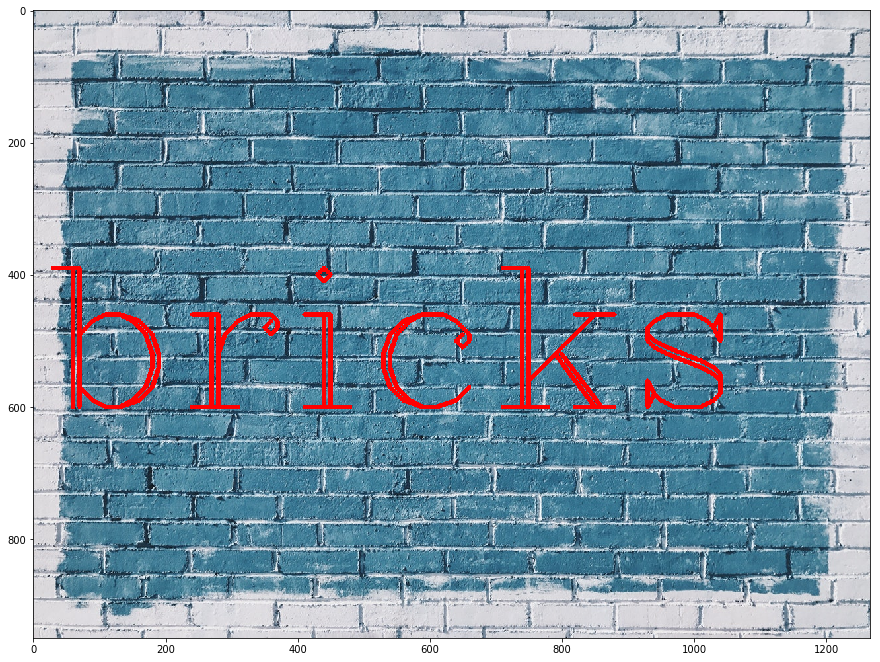

In [36]:
img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))

In [37]:
kernel = np.ones((5,5),dtype=np.float32) / 25
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


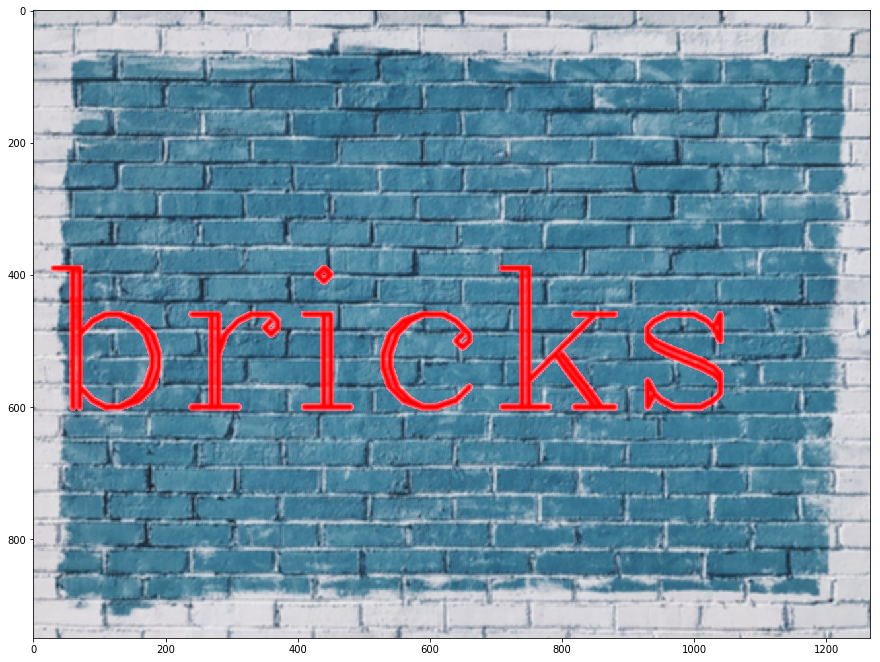

In [38]:
dst = cv2.filter2D(img,-1,kernel)
show_img(dst)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


reset


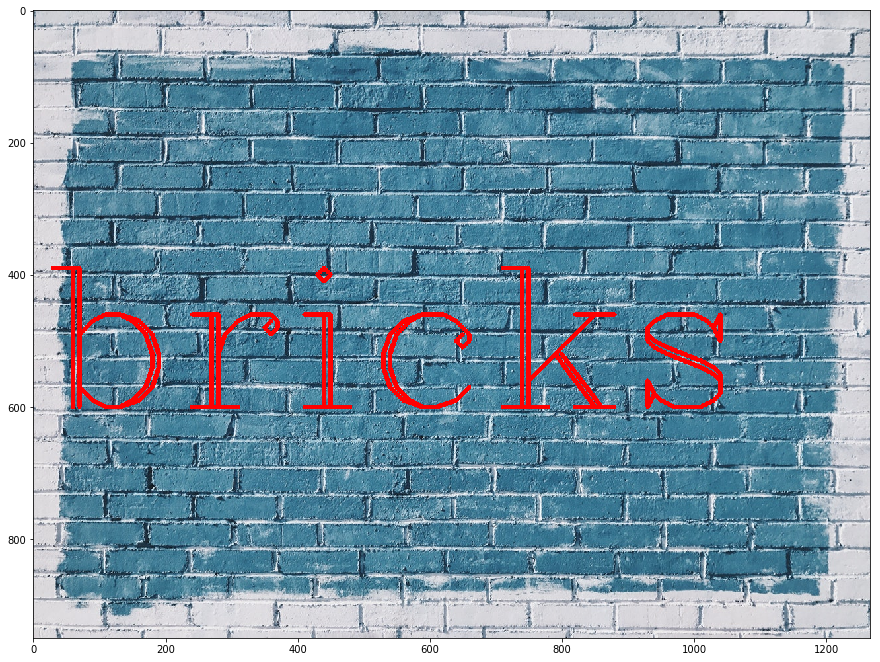

In [39]:
img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))
print('reset')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


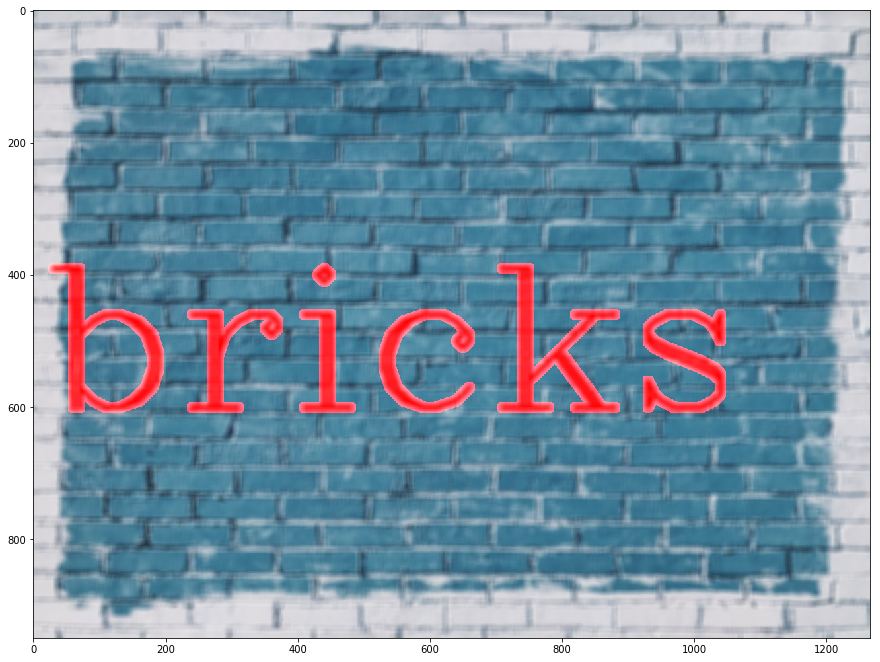

In [44]:
blurred = cv2.blur(img,ksize = (10,10))
show_img(blurred)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


reset


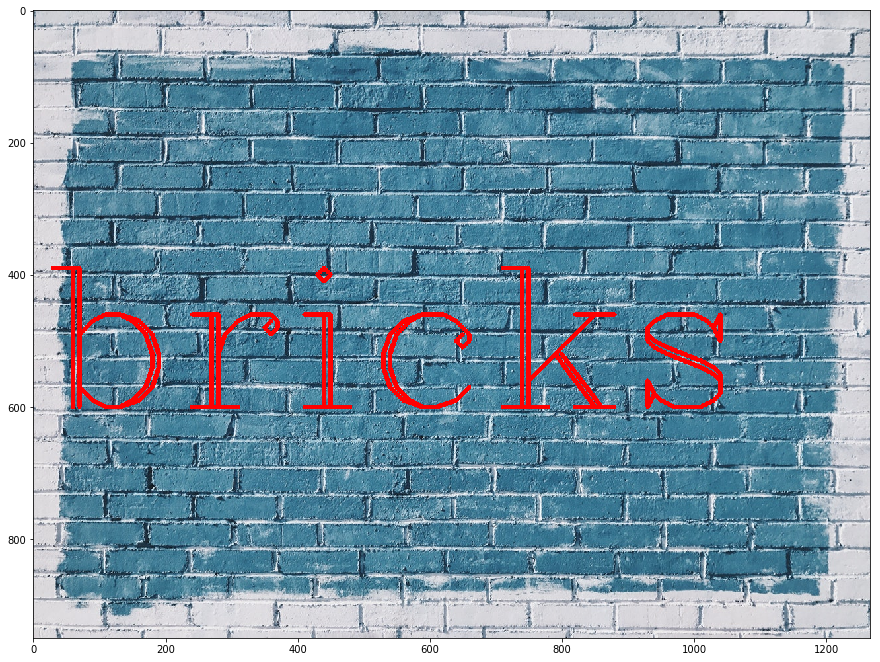

In [45]:
img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))
print('reset')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


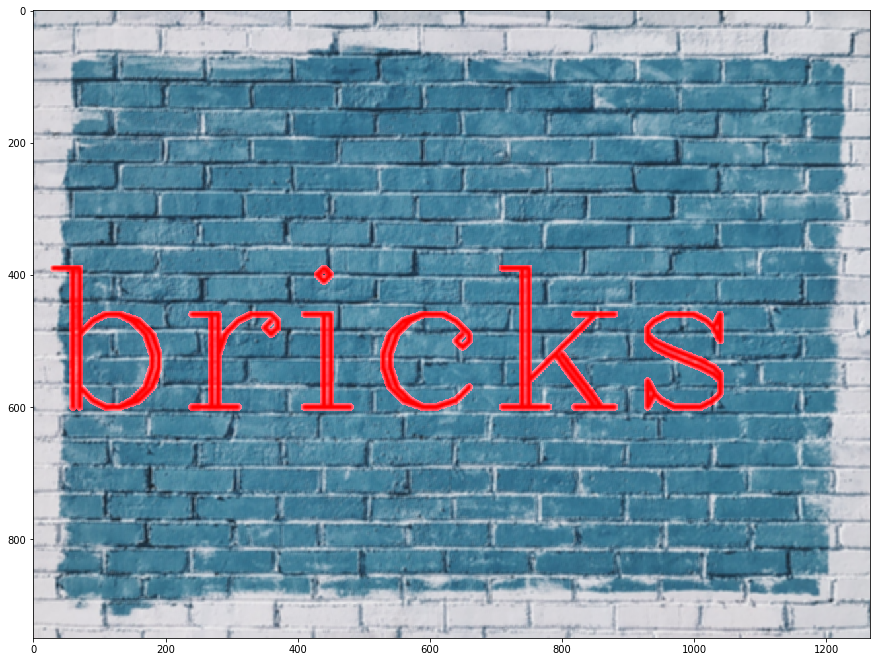

In [47]:
gaussian_blur = cv2.GaussianBlur(img,(5,5),10)
show_img(gaussian_blur)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


reset


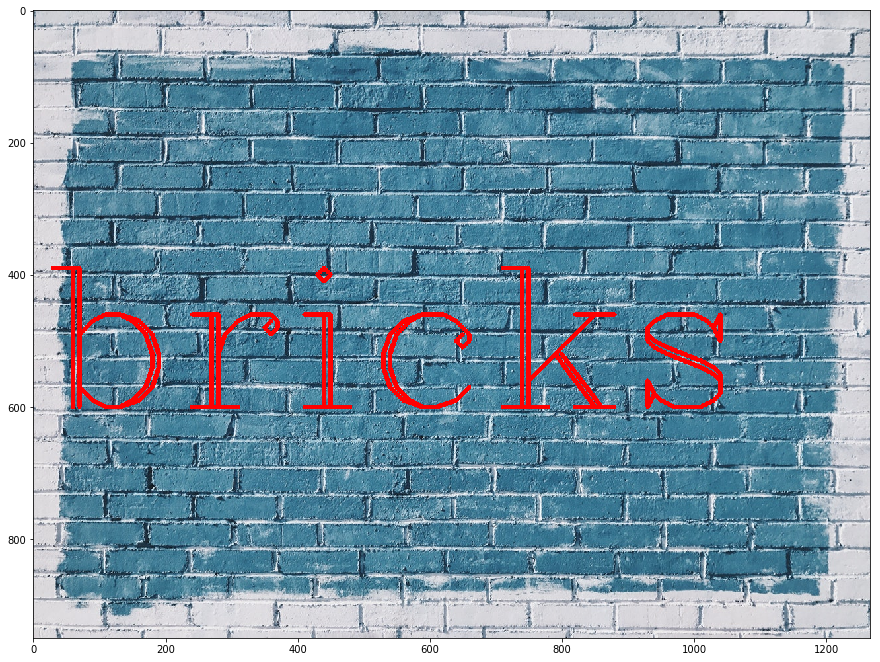

In [48]:
img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))
print('reset')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


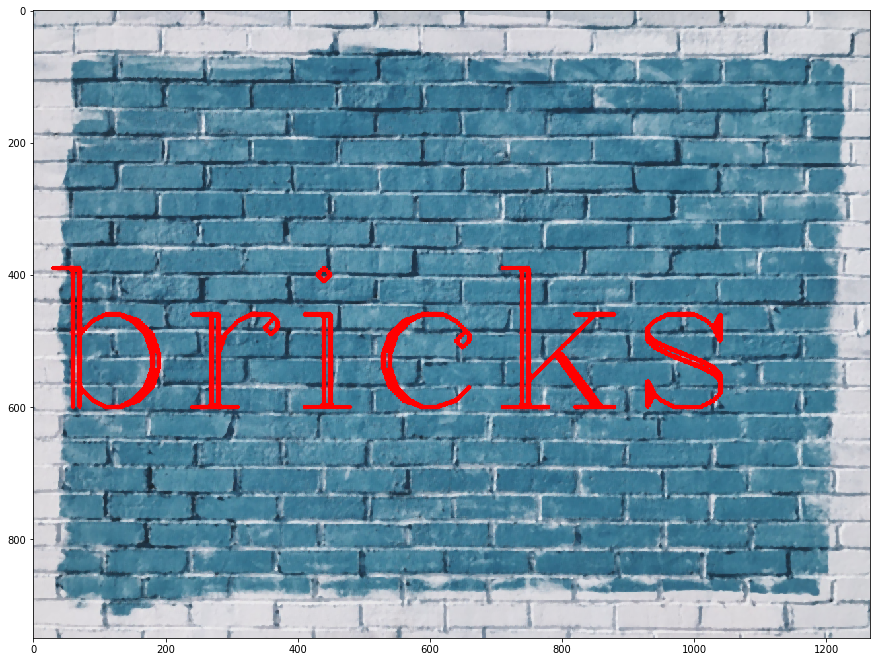

In [49]:
median_blur = cv2.medianBlur(img,5)
show_img(median_blur)

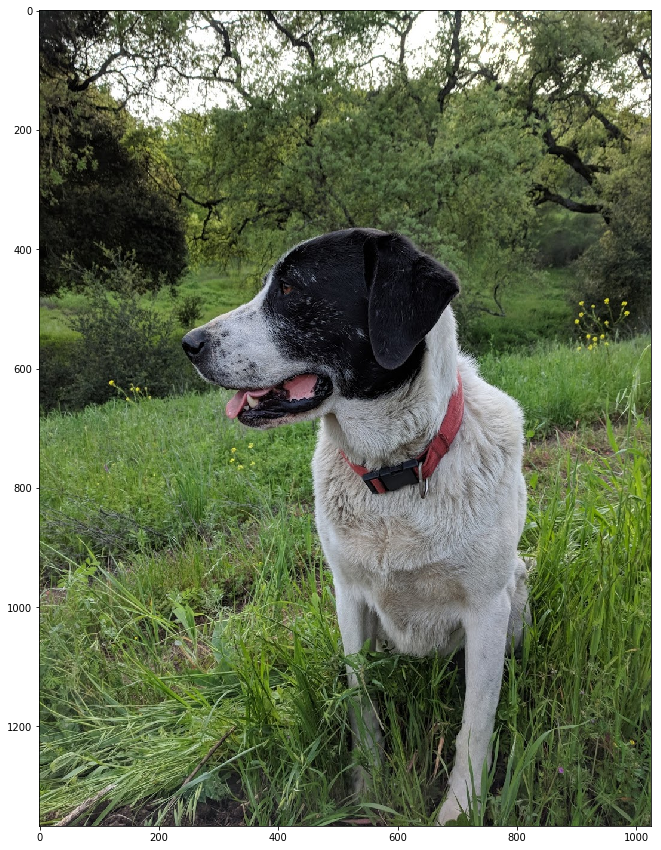

In [50]:
img = cv2.cvtColor(cv2.imread('../Data/sammy.jpg'),cv2.COLOR_BGR2RGB)
show_img(img)

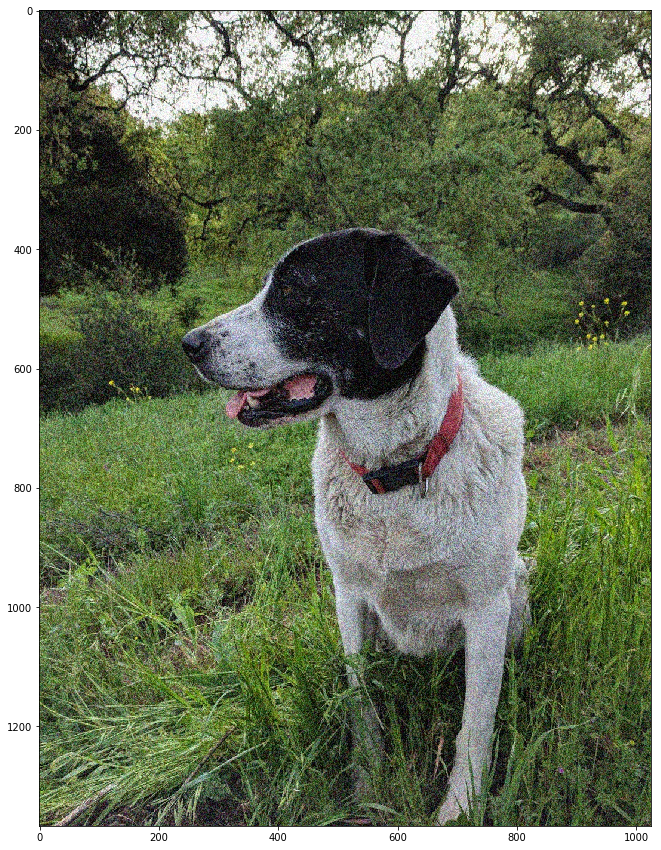

In [53]:
noisy_img = cv2.imread('../Data/sammy_noise.jpg')
show_img(noisy_img)

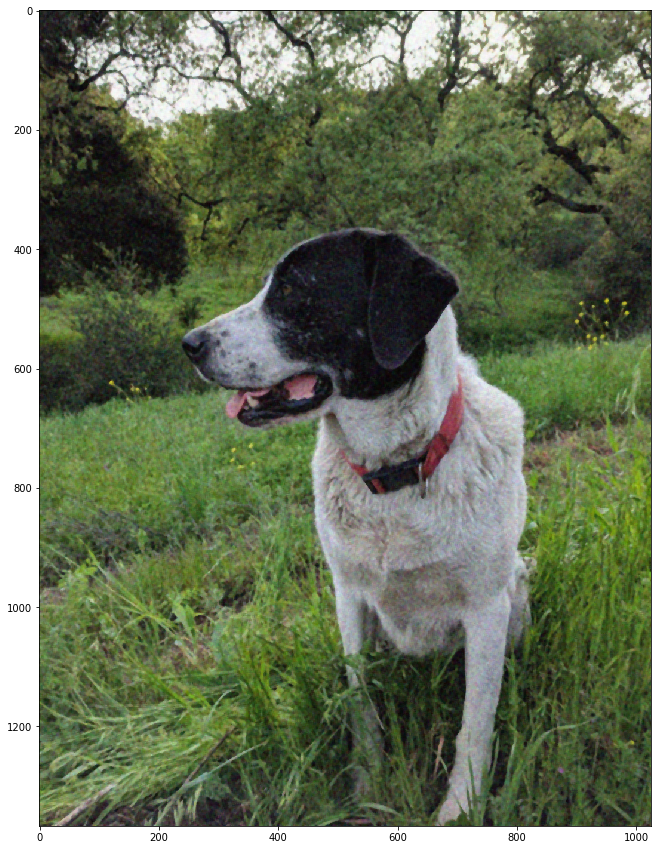

In [54]:
median = cv2.medianBlur(noisy_img,5)
show_img(median)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


reset


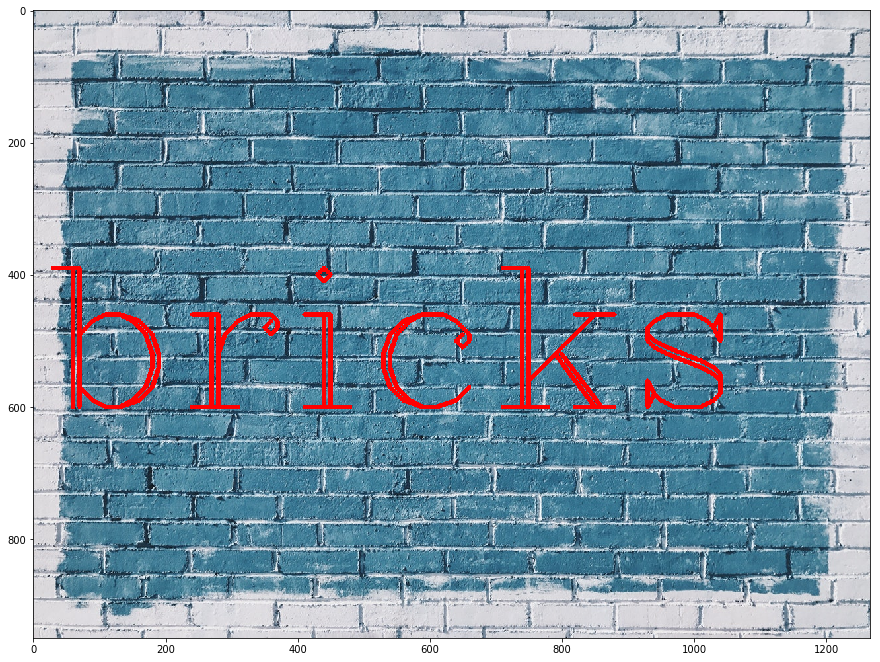

In [55]:
img= load_img()
font = cv2.FONT_HERSHEY_COMPLEX
show_img(cv2.putText(img,text = 'bricks', org = (10,600),fontFace = font,
            fontScale=10,color = (255,0,0),thickness = 5))
print('reset')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


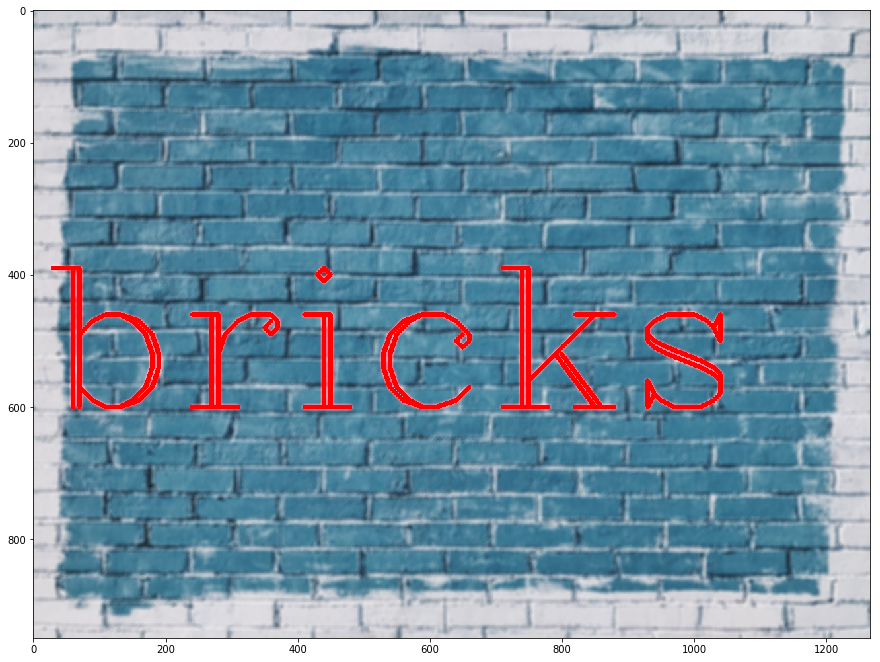

In [57]:
blur = cv2.bilateralFilter(img,9,75,75)
show_img(blur)

#### Class 5 Morphological Operators

- MO are sets of kernels that can achienve a variety of effects such as reducing noise
- Certain operators are very good at reducing black points on a white background
- Certain operators can also achieve an erosion and dilation effect that can add or erode from an existing image
- This effect is mostly seen on text data, so we will practisce various morphological operators on some simple white text on a  balck background.

In [68]:
def load_img():
    blank_img = np.zeros((600,600))
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(blank_img,text='ABCDE',org=(20,400),fontFace = font,
               fontScale = 5,color= (255,255,255),thickness = 30)
    return blank_img

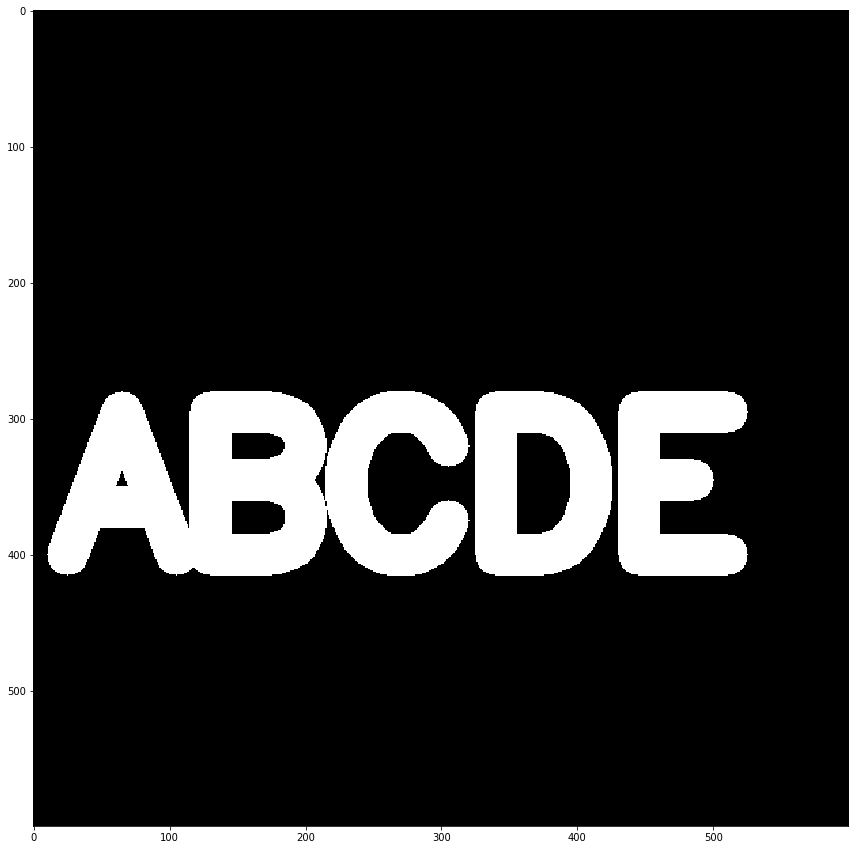

In [69]:
img = load_img()
show_img(img)

In [70]:
kernel = np.ones((5,5),dtype=np.uint8)

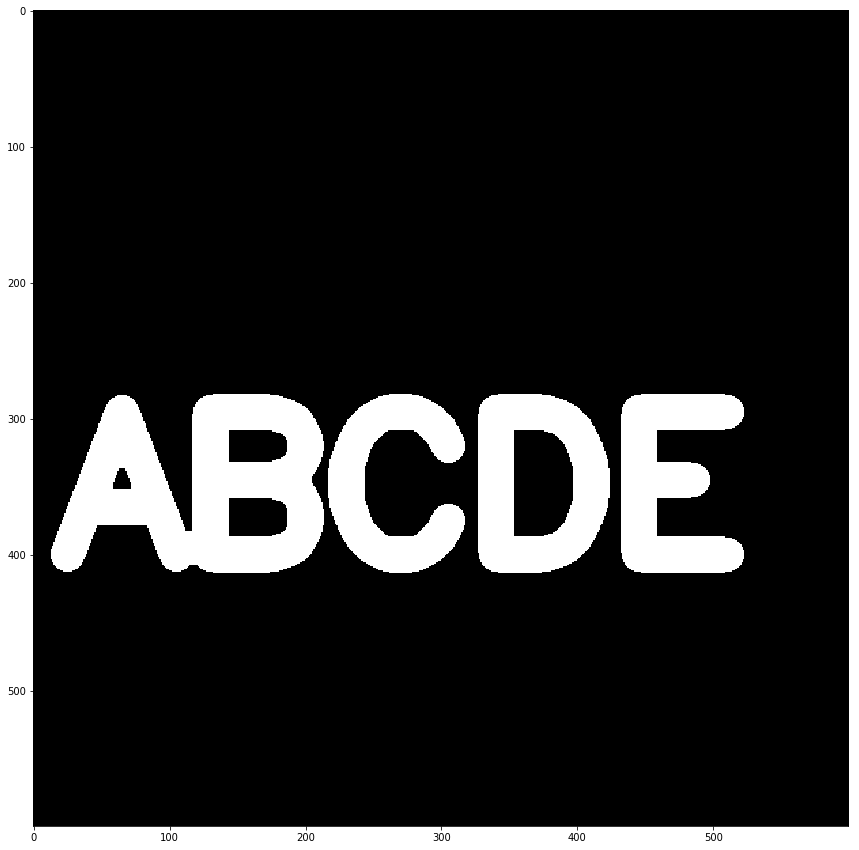

In [71]:
result = cv2.erode(img,kernel,iterations = 1)
show_img(result)

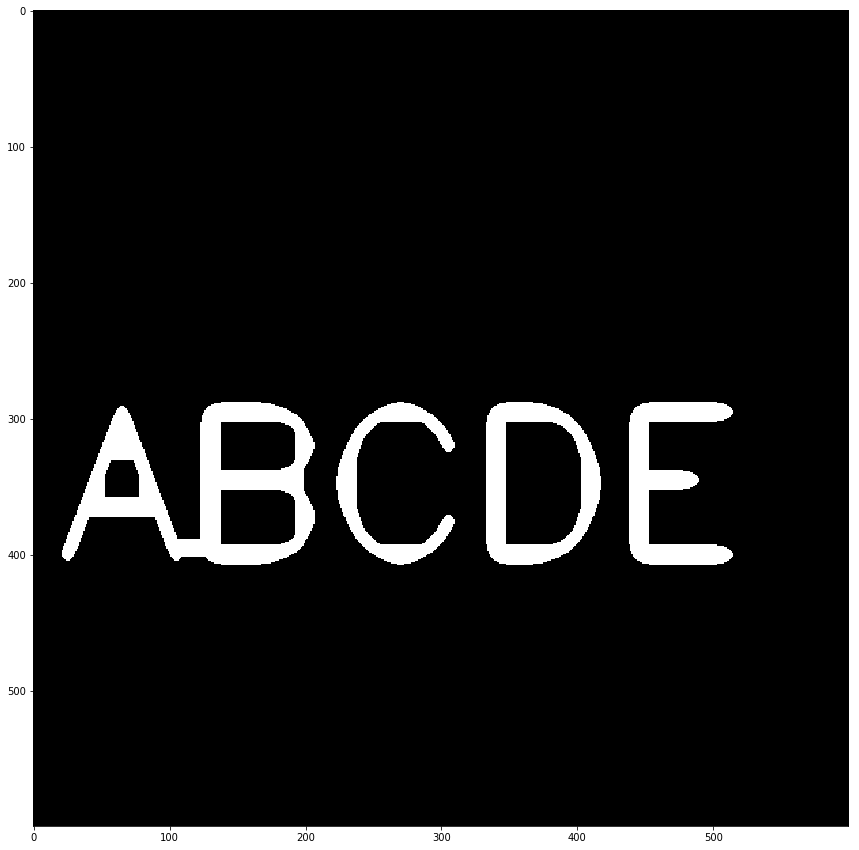

In [72]:
result = cv2.erode(img,kernel,iterations = 4)
show_img(result)

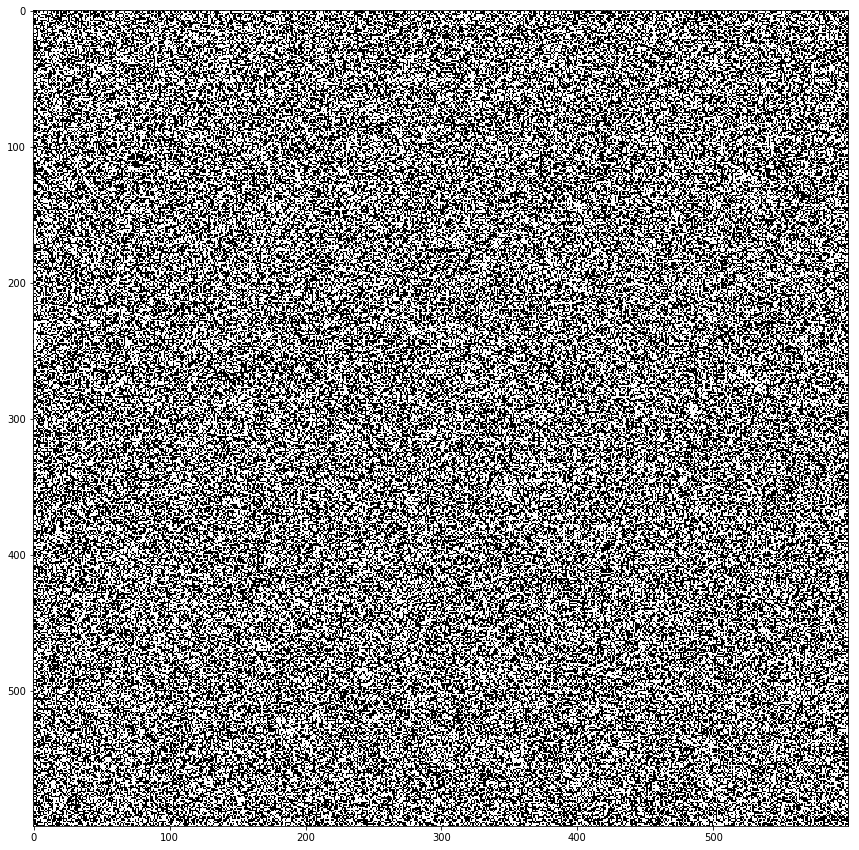

In [73]:
img = load_img()
#creating white noise
white_noise = np.random.randint(0,2,size=(600,600))
show_img(white_noise)

In [74]:
white_noise = white_noise * 255

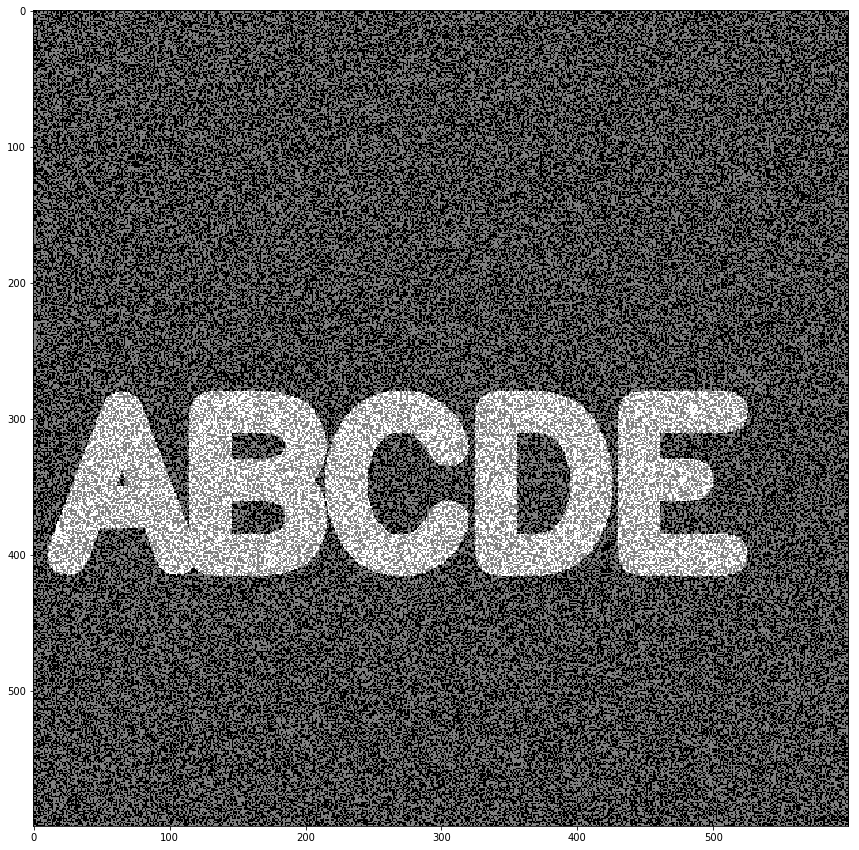

In [75]:
noise_img = white_noise + img
show_img(noise_img)

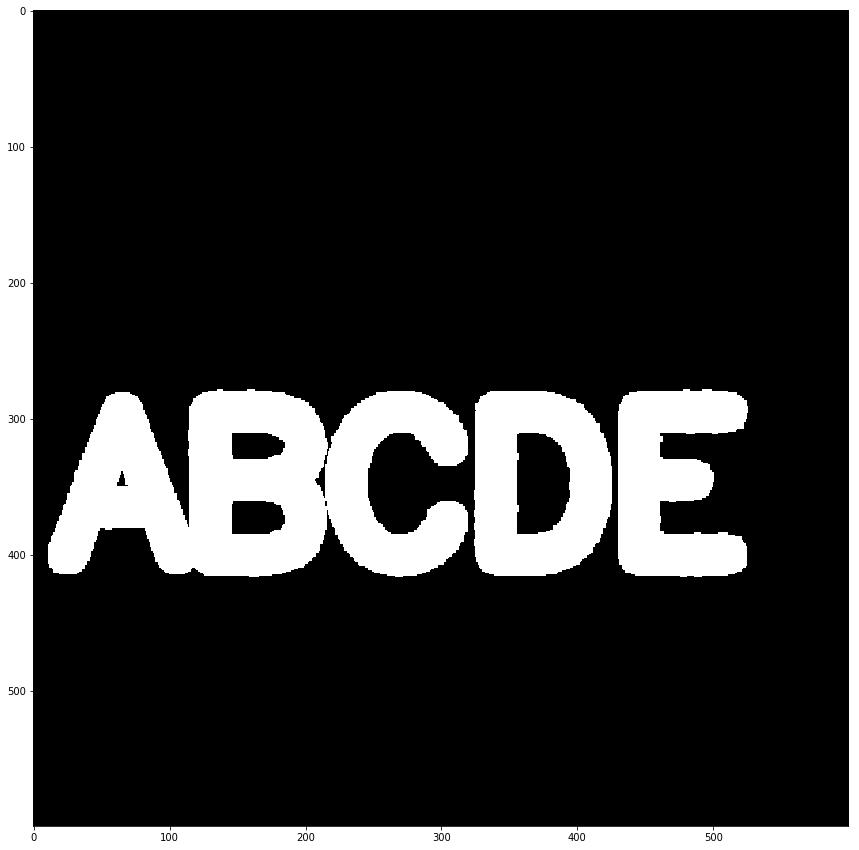

In [76]:
# opening is used to clean up the noise
opening = cv2.morphologyEx(noise_img,cv2.MORPH_OPEN,kernel)
show_img(opening)

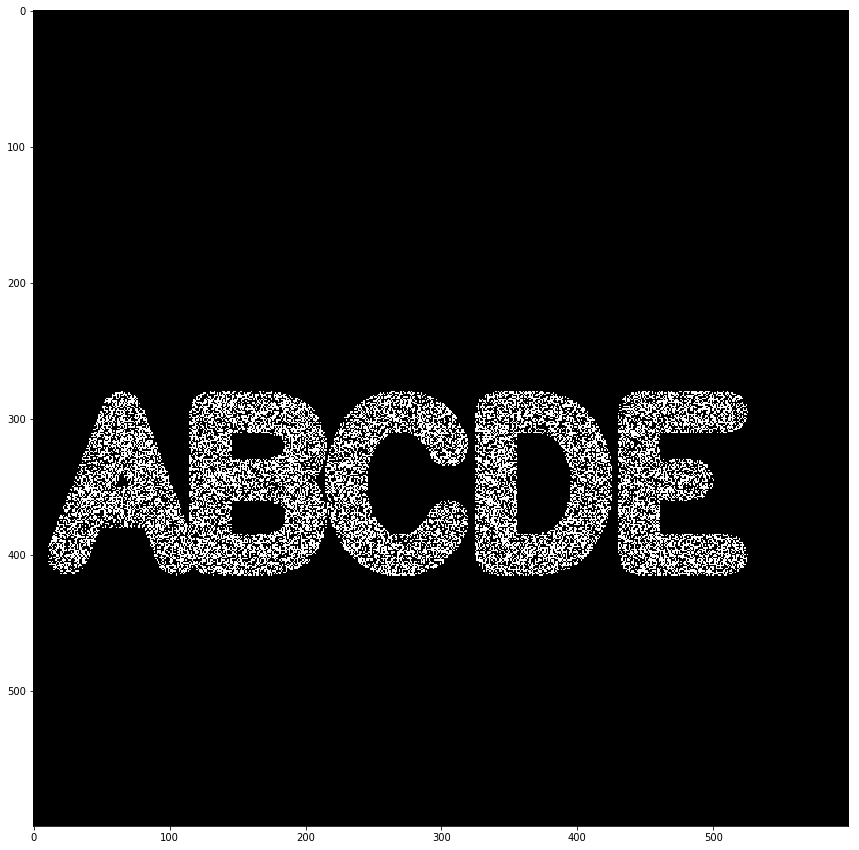

In [78]:
img = load_img()
black_noise = np.random.randint(0,2,(600,600))
black_noise = black_noise * -255
black_noise = black_noise + img
black_noise[black_noise==-255] =0
show_img(black_noise)

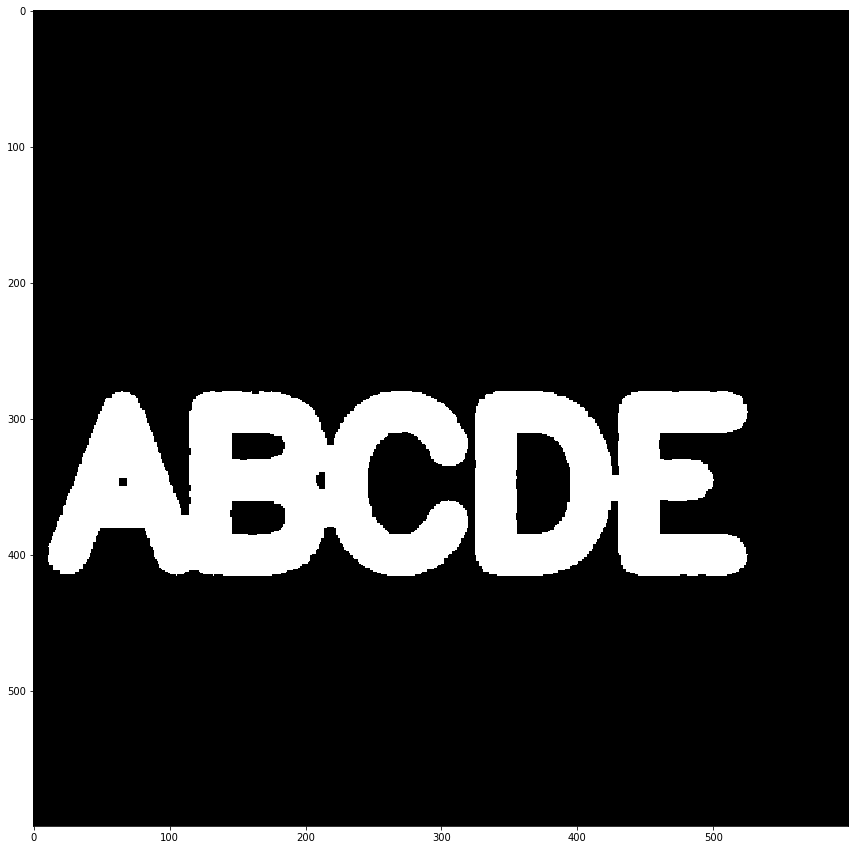

In [79]:
closing = cv2.morphologyEx(black_noise,cv2.MORPH_CLOSE,kernel)
show_img(closing)

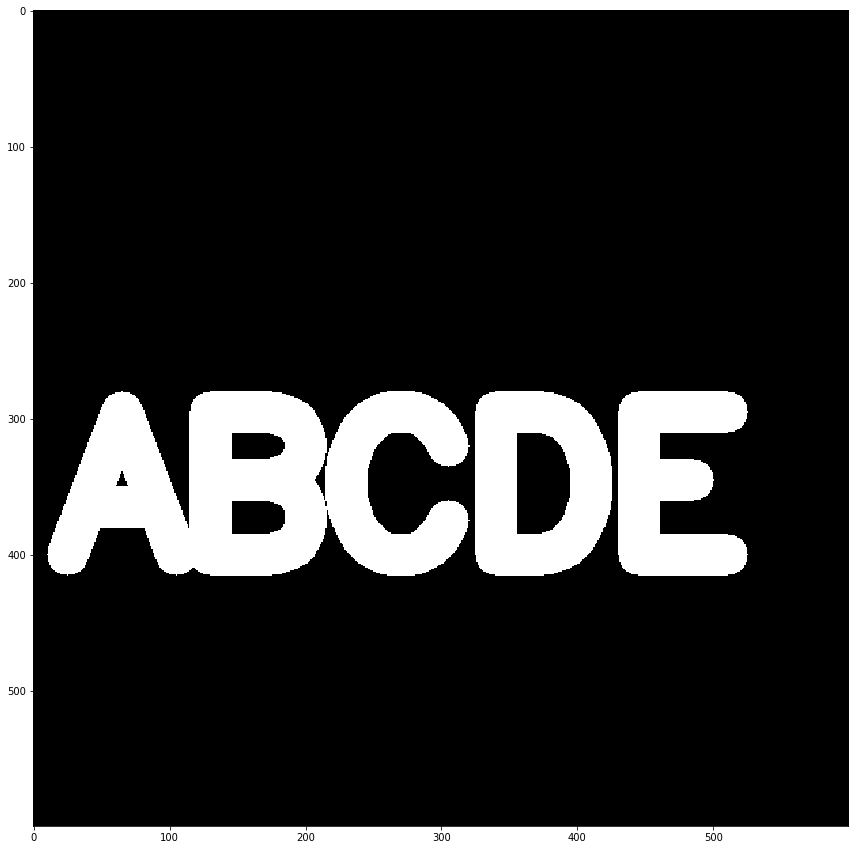

In [80]:
img = load_img()
show_img(img)

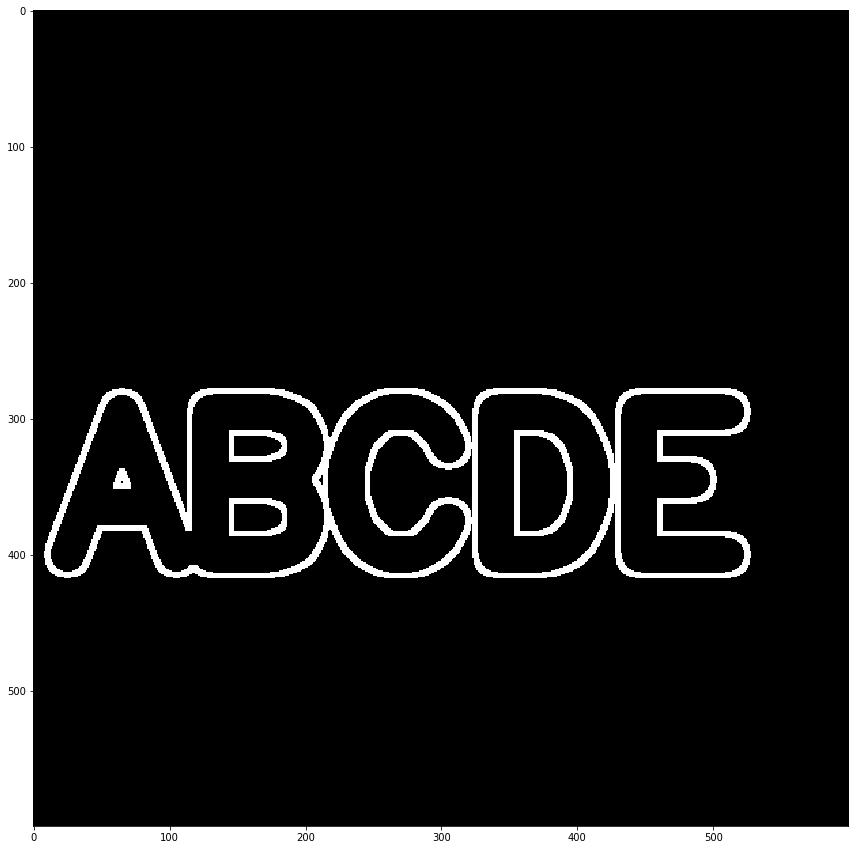

In [81]:
gradient = cv2.morphologyEx(img,cv2.MORPH_GRADIENT,kernel)
show_img(gradient)
#thisis the difference between erosion and dialation

#### Class 6 - Gradient

- An image gradient is a directional change in the intensity or color in an image
- Gradients can be calculated in a specific direction


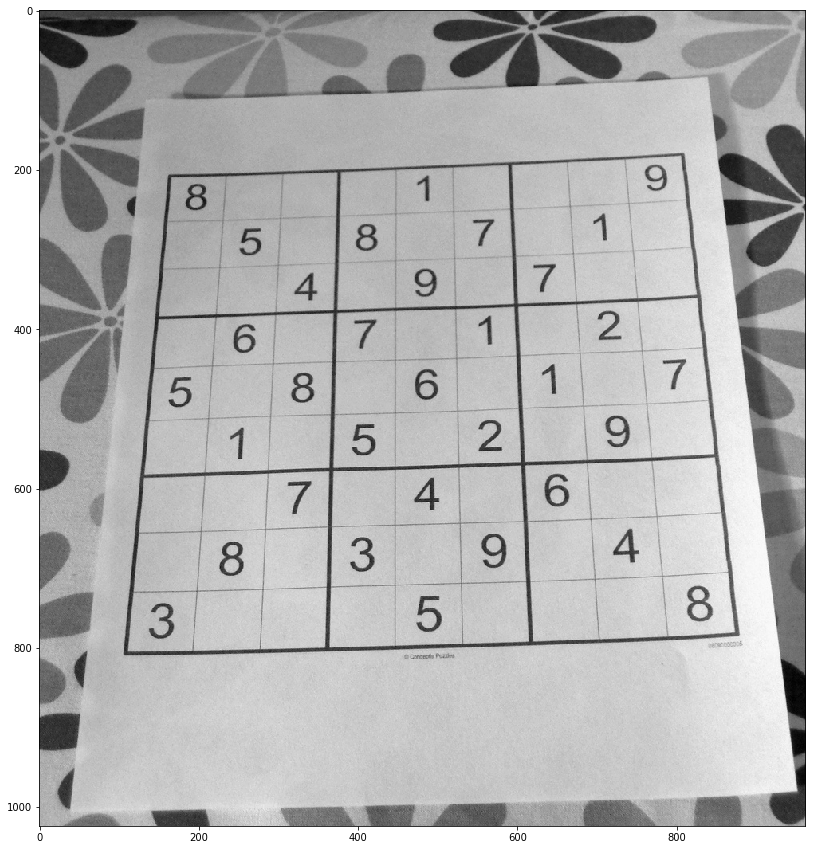

In [86]:
img =cv2.imread('../Data/sudoku.jpg',0)
show_img(img)

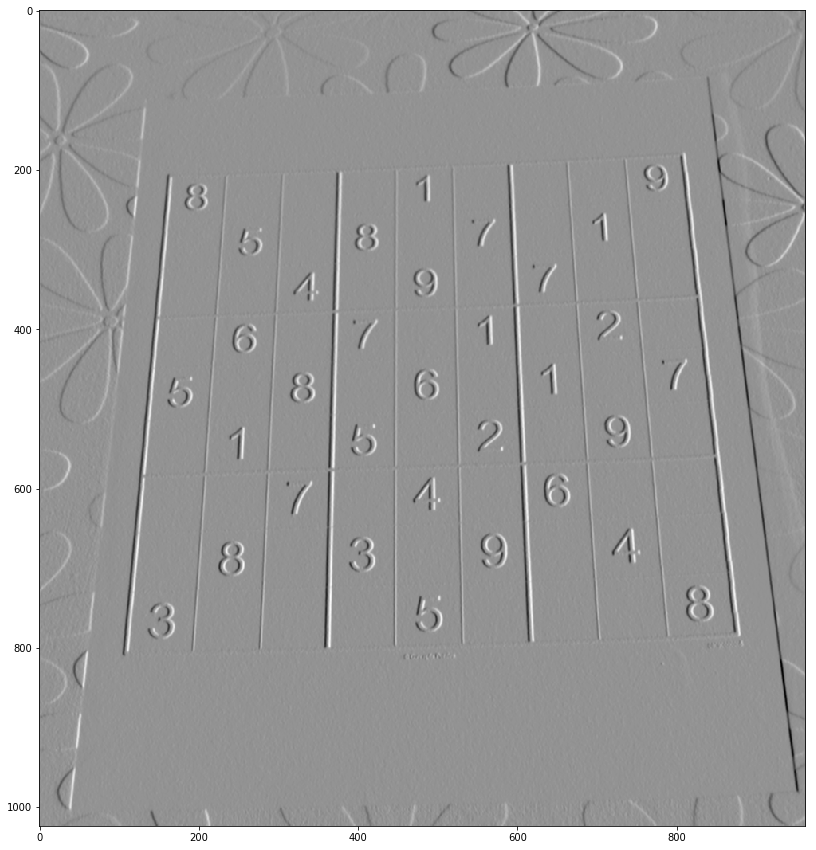

In [87]:
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)
show_img(sobelx)

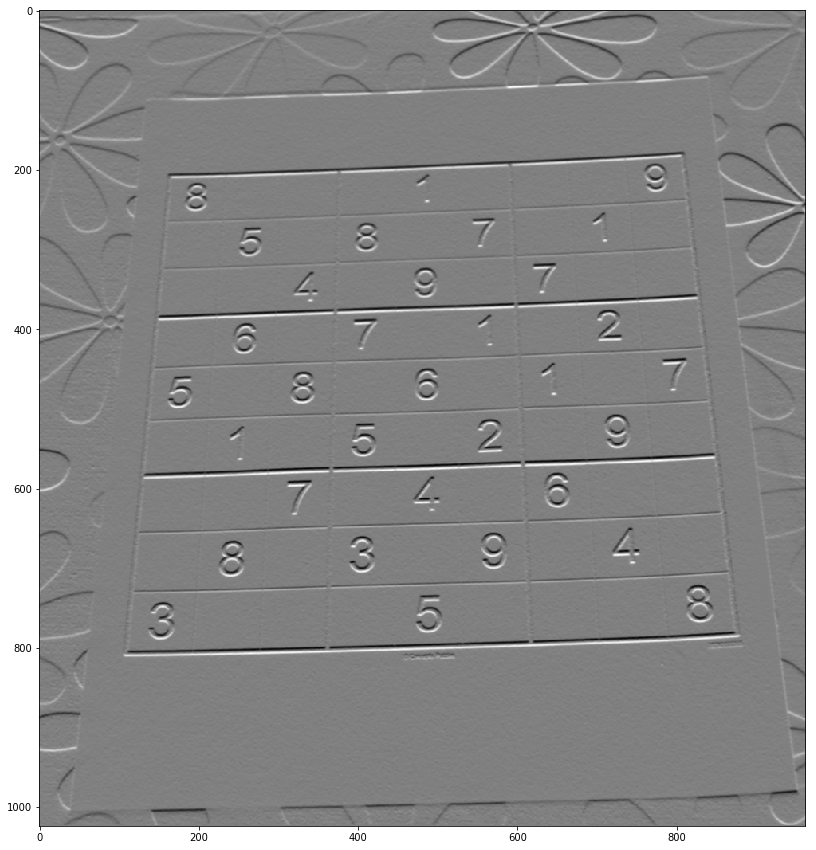

In [88]:
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)
show_img(sobely)

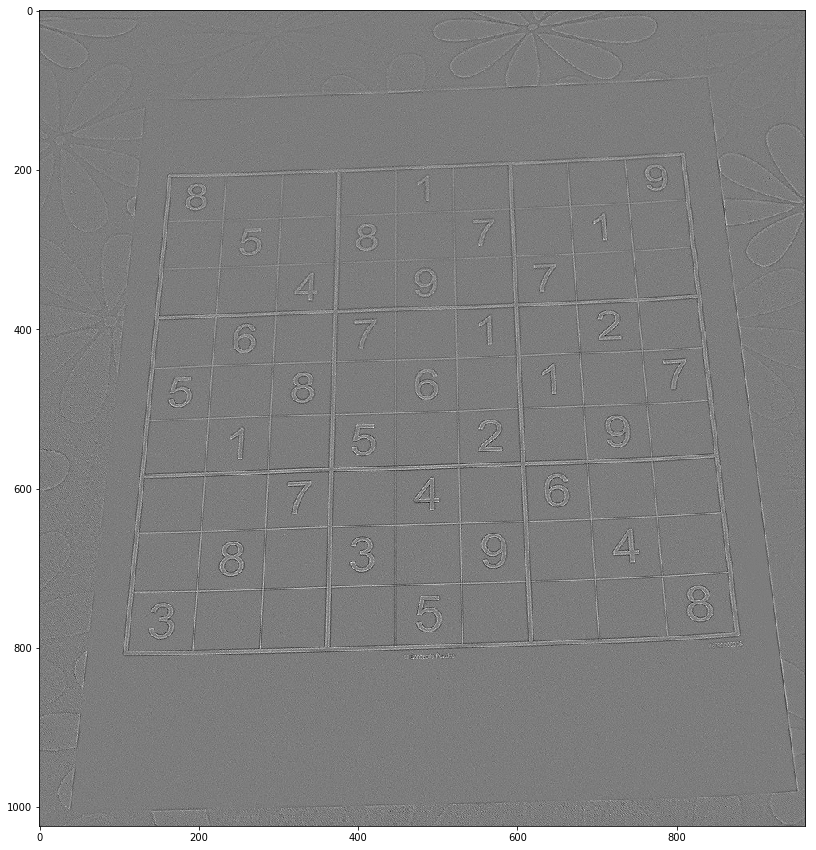

In [89]:
laplacian = cv2.Laplacian(img,cv2.CV_64F)
show_img(laplacian)

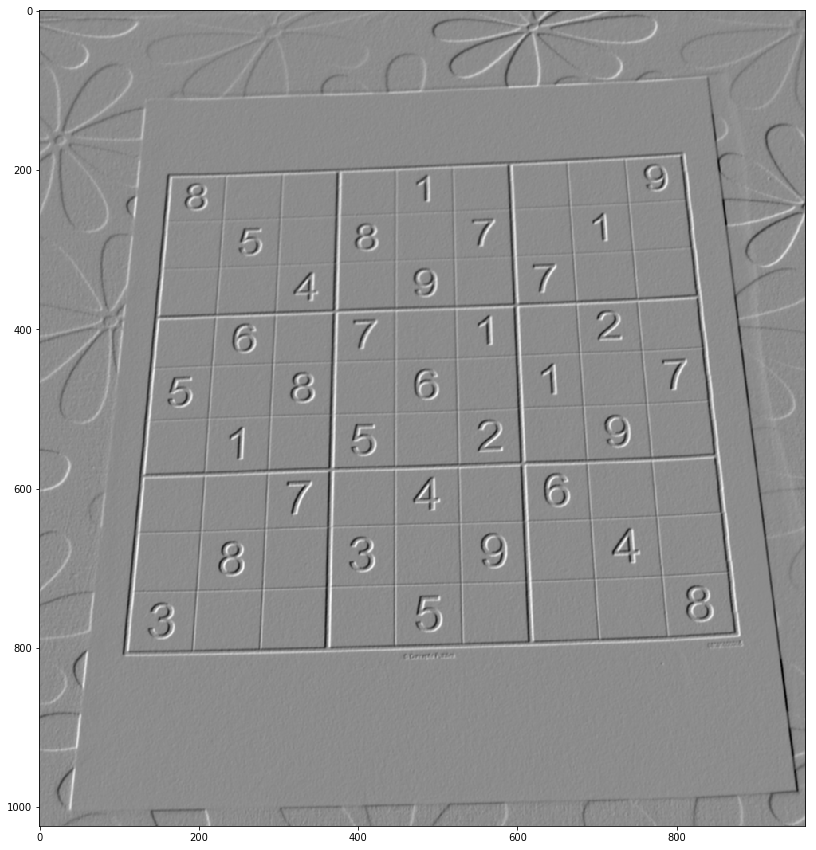

In [90]:
blended = cv2.addWeighted(sobelx,0.6,sobely,0.3,0)
show_img(blended)

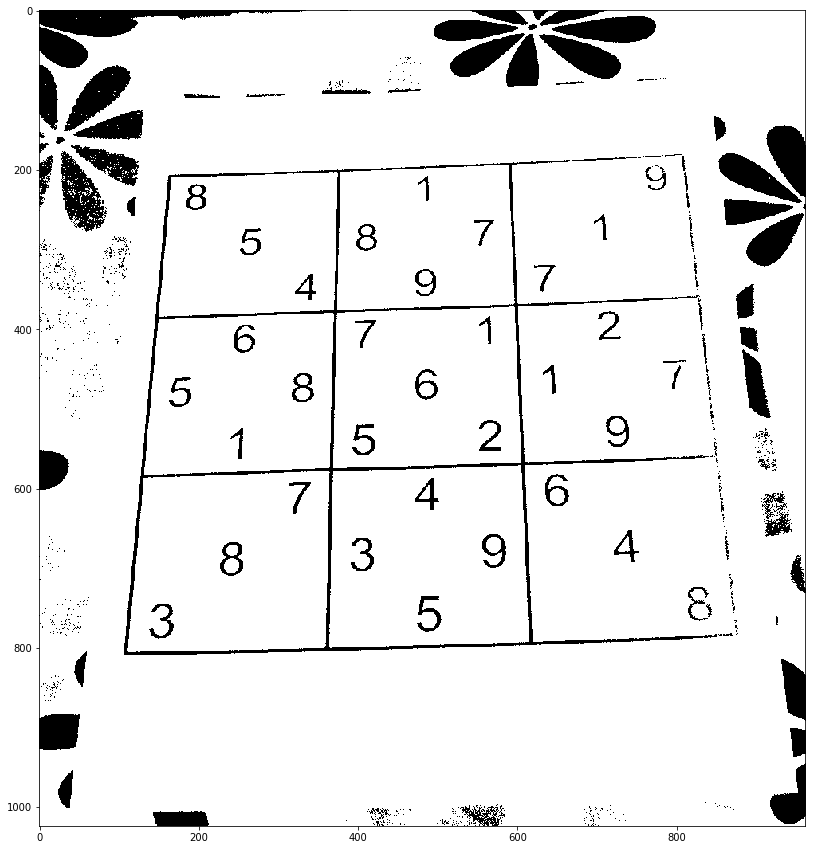

In [95]:
ret,thr = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
show_img(thr)

#### Class 7 - Histograms

- Histogram is the visual representation of the distribution of a continous feature


In [97]:
dark_horse = cv2.imread('../Data/horse.jpg') #for opencv
show_horse = cv2.cvtColor(dark_horse,cv2.COLOR_BGR2RGB) # for matplotlib

rainbow = cv2.imread('../Data/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow,cv2.COLOR_BGR2RGB)

bricks = cv2.imread('../Data/bricks.jpg')
show_bricks = cv2.cvtColor(bricks,cv2.COLOR_BGR2RGB)

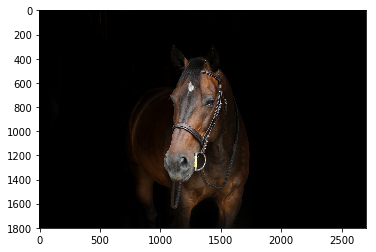

In [98]:
plt.imshow(show_horse)

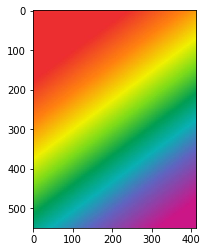

In [99]:
plt.imshow(show_rainbow)

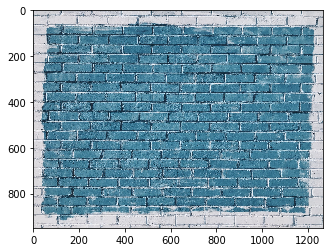

In [100]:
plt.imshow(show_bricks)

In [101]:
hist_values = cv2.calcHist([bricks],channels=[0],mask=None,
             histSize=[256],ranges=[0,256])

In [103]:
hist_values.shape

(256, 1)

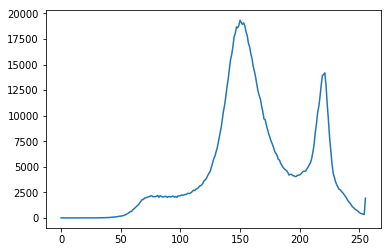

In [105]:
plt.plot(hist_values)

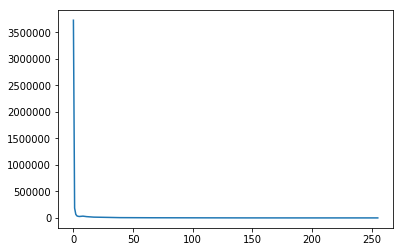

In [106]:
hist_values = cv2.calcHist([dark_horse],channels=[0],mask=None,
             histSize=[256],ranges=[0,256])
plt.plot(hist_values)

In [107]:
img = bricks

Text(0.5, 1.0, 'Histogram of Blue bricks')

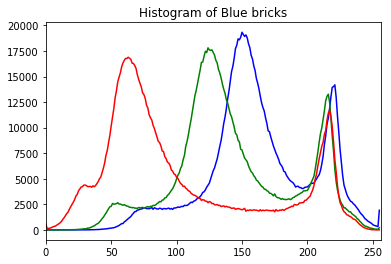

In [108]:
color = ('b','g','r')

for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Histogram of Blue bricks')

#### Histogram Equalization

- Is a method of contrast adjustment based on the image's histogram

- Making the cumulative histogram much more linear... means you are increasing the contrast of an image

In [110]:
img = rainbow
img.shape

(550, 413, 3)

In [111]:
#creating mask
mask = np.zeros(img.shape[:2],np.uint8)

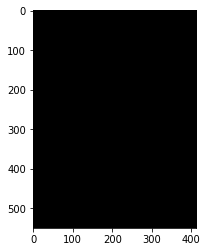

In [113]:
plt.imshow(mask,cmap='gray')

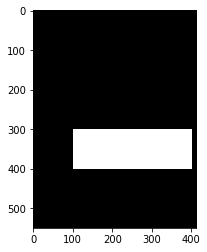

In [114]:
mask[300:400,100:400] = 255
plt.imshow(mask,cmap = 'gray')

In [116]:
masked_img = cv2.bitwise_and(img,img,mask=mask)
show_masked_img = cv2.bitwise_and(show_rainbow,show_rainbow,mask = mask)

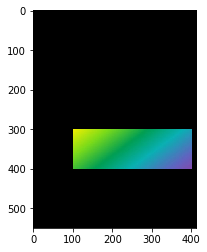

In [119]:
plt.imshow(show_masked_img)

In [120]:
hist_mask_values_red = cv2.calcHist([rainbow],[2],mask,[256],[0,256])

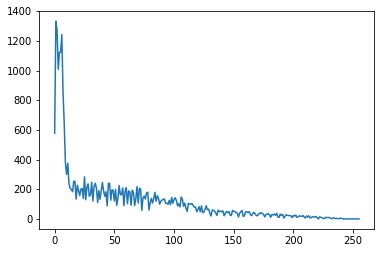

In [121]:
plt.plot(hist_mask_values_red)

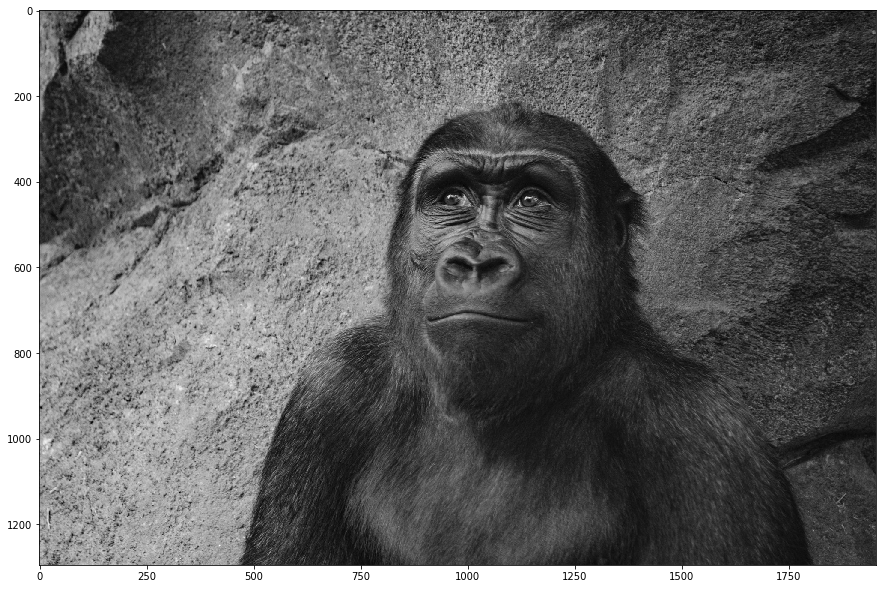

In [122]:
gorilla = cv2.imread('../Data/gorilla.jpg',0)
show_img(gorilla)

In [125]:
hist_values = cv2.calcHist([gorilla],[0],mask=None,histSize=[256],ranges=[0,256])

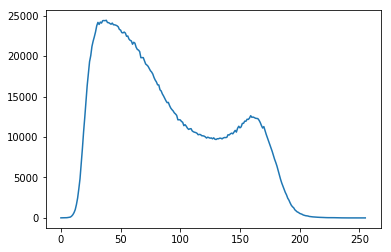

In [126]:
plt.plot(hist_values)

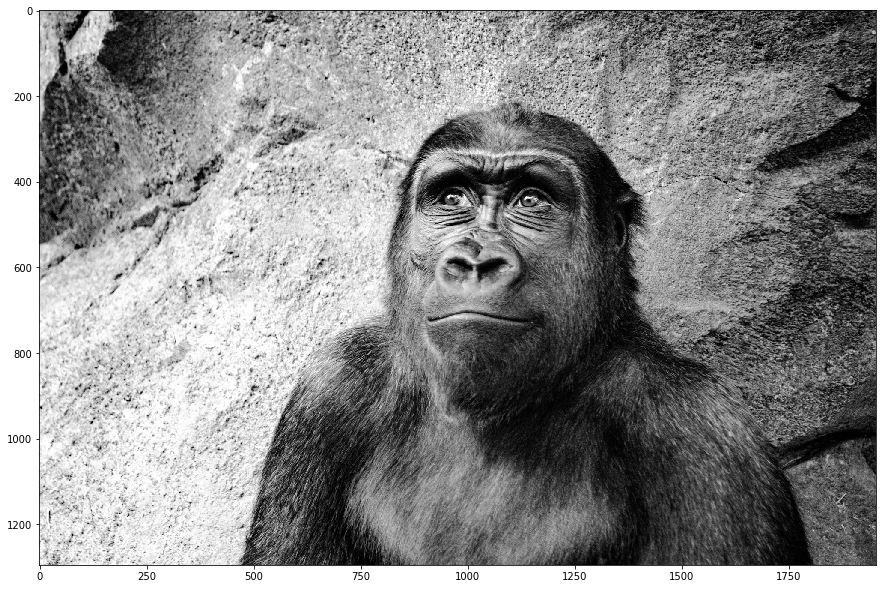

In [127]:
eq_gorilla = cv2.equalizeHist(gorilla)
show_img(eq_gorilla)

In [128]:
hist_values = cv2.calcHist([eq_gorilla],[0],mask=None,histSize=[256],ranges=[0,256])

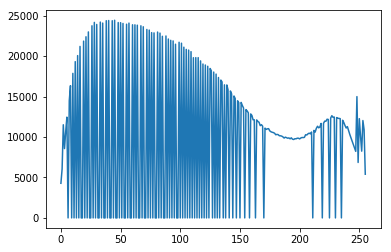

In [129]:
plt.plot(hist_values)

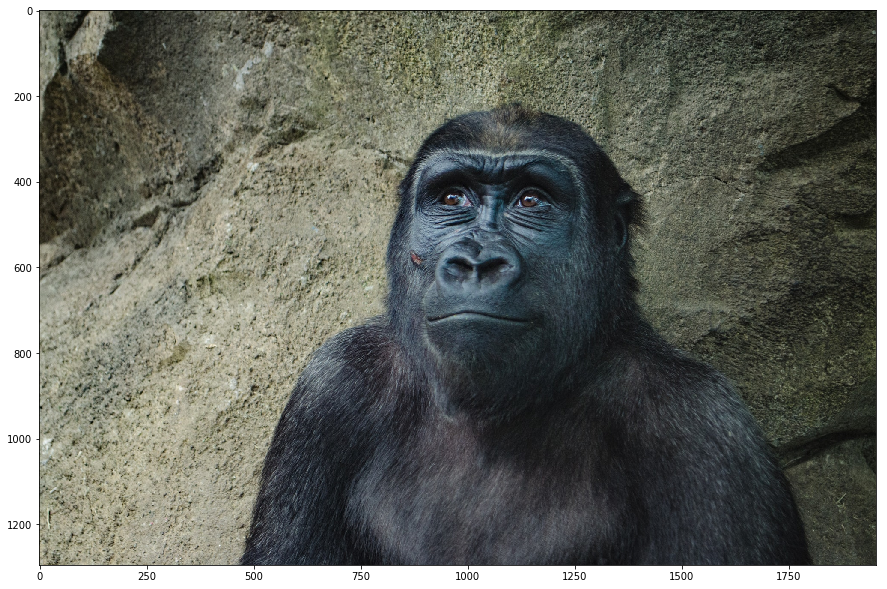

In [130]:
color_gorilla = cv2.imread('../Data/gorilla.jpg')
show_gorilla = cv2.cvtColor(color_gorilla,cv2.COLOR_BGR2RGB)
show_img(show_gorilla)

In [131]:
hsv = cv2.cvtColor(color_gorilla,cv2.COLOR_BGR2HSV)

In [132]:
hsv[:,:,2].min()

1

In [133]:
hsv[:,:,2] = cv2.equalizeHist(hsv[:,:,2])

In [134]:
eq_color_gorilla = cv2.cvtColor(hsv,cv2.COLOR_HSV2RGB)

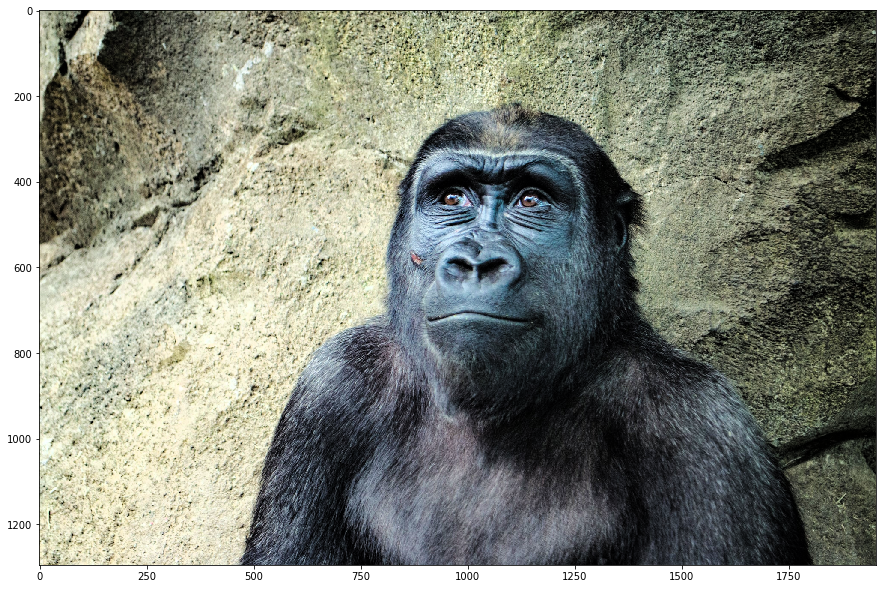

In [135]:
show_img(eq_color_gorilla)